## About Data

- This is a transnational data set which contains all the transactions occurring between 01/12/2010 and 09/12/2011 for a UK-based and registered non-store online retail. The company mainly sells unique all-occasion gifts. Many customers of the company are wholesalers.

- For a better understanding and more information, please refer to https://archive.ics.uci.edu/ml/datasets/Online+Retail

## The features in the given dataset are:

- InvoiceNo: Invoice number. Nominal, a 6-digit integral number uniquely assigned to each transaction. If this code starts with letter 'c', it indicates a cancellation.
- StockCode: Product (item) code. Nominal, a 5-digit integral number uniquely assigned to each distinct product.
- Description: Product (item) name. Nominal.
- Quantity: The quantities of each product (item) per transaction. Numeric.
- InvoiceDate: Invoice Date and time. Numeric, the day and time when each transaction was generated.
- UnitPrice: Unit price. Numeric, Product price per unit in sterling.
- CustomerID: Customer number. Nominal, a 5-digit integral number uniquely assigned to each customer.
- Country: Country name. Nominal, the name of the country where each customer resides.

## Problem statement
1. Using the above data, find useful insights about the customer purchasing history that can be an added advantage for the online retailer.
2. Segment the customers based on their purchasing behavior.

## Solution Proposed

1. First of all, to observe the structure of the data and missing values, you can use exploratory data analysis and data visualization techniques.


2. You must do descriptive analysis. Because you must understand the relationship of the features to each other and clear the noise and missing values in the data.


3. Analyse the distribution of Orders, Customers and Countries. These analyzes will help the company develop its sales policies and contribute to the correct use of resources. After that, the data set will be ready for RFM analysis.


   - RFM analysis is a data-driven customer behavior segmentation technique where RFM stands for recency, frequency, and monetary value.

   - The idea is to segment customers based on when their last purchase was(Recency), how often they’ve purchased in the past(Frequency), and how much they spent(Monetary). All three of these measures have proven to be effective predictors of a customer’s willingness to engage in marketing messages and offers.


4. Segment the customers based on past purchasing behavior by RFM analysis.


5. By using RFM Analysis, you can enable companies to develop different approaches to different customer segments so that they can get to know their customers better, observe trends better, and increase customer retention and sales revenues.


6. Calculate the Recency, Frequency and Monetary values of the customers in the RFM Analysis using the data.


7. In the Customer Segmentation section, create an RFM Segmentation Table where you segment your customers by using the RFM table. For example, you can label the best customer as "Big Spenders" and the lost customer as "Lost Customer".


8. We will segment the customers ourselves based on their recency, frequency, and monetary values. But can an unsupervised learning model do this better for us? You will use the K-Means algorithm to find the answer to this question. Then you will compare the classification made by the algorithm with the classification you have made yourself.


9. Finally, you will do Cohort Analysis with the data you used at the beginning, regardless of the analysis you have done before. Cohort analysis is a subset of behavioral analytics that takes the user data and breaks them into related groups for analysis. This analysis can further be used to do customer segmentation and track metrics like retention, churn, and lifetime value.

- Descriptive analytics: What happened?
- Diagnostic analytics: Why did it happen?
- Predictive analytics: What is likely to happen in the future?
- Prescriptive analytics: What is the best course of action to take?

In [1]:
#!pip install pyforest

In [2]:
# !pip install pyforest
# 1-Import Libraies
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
import datetime as dt
%matplotlib inline
import statsmodels.api as sm
import statsmodels.formula.api as smf 
import plotly.express as px
import plotly.graph_objects as go

from sklearn.compose import make_column_transformer

# Scaling
from sklearn.preprocessing import scale 
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures 
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PowerTransformer 
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import RobustScaler

# Modelling
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Importing plotly and cufflinks in offline mode
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

# Figure&Display options
plt.rcParams["figure.figsize"] = (16, 9)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.2f' % x)

# !pip install termcolor
import colorama
from colorama import Fore, Style  # makes strings colored
from termcolor import colored
from termcolor import cprint

import ipywidgets
from ipywidgets import interact

# !pip install -U pandas-profiling --user
import pandas_profiling
from pandas_profiling.report.presentation.flavours.html.templates import create_html_assets

# !pip install wordcloud
from wordcloud import WordCloud


In [3]:
#!pip install cufflinks

In [4]:
#!pip install termcolor

In [5]:
#!pip install squarify

In [6]:
#!pip install -U pandas-profiling --user

In [7]:
#!pip install wordcloud

## Reading the data

In [8]:
df = pd.read_csv("Online_Retail.csv", encoding='windows-1252')

In [9]:
df

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/10 8:26,2.55,17850.00,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/10 8:26,3.39,17850.00,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/10 8:26,2.75,17850.00,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/10 8:26,3.39,17850.00,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/10 8:26,3.39,17850.00,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,12/9/11 12:50,0.85,12680.00,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,12/9/11 12:50,2.10,12680.00,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,12/9/11 12:50,4.15,12680.00,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,12/9/11 12:50,4.15,12680.00,France


In [10]:
count=0
for columns in df:
    if (len(df[columns]) - df[columns].count()) == len(df[columns]):
        count+=1

In [11]:
len(df["InvoiceNo"])

541909

In [12]:
df["InvoiceNo"].count()

541909

### Certain user defined functions

In [13]:
def missing_values(df):
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.shape[0]).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values[missing_values['Missing_Number']>0]

In [14]:
def first_looking(df):
    print(colored("Shape:", attrs=['bold']), df.shape,'\n', 
          colored('*'*100, 'red', attrs=['bold']),
          colored("\nInfo:\n", attrs=['bold']), sep='')
    print(df.info(), '\n', 
          colored('*'*100, 'red', attrs=['bold']), sep='')
    print(colored("Number of Uniques:\n", attrs=['bold']), df.nunique(),'\n',
          colored('*'*100, 'red', attrs=['bold']), sep='')
    print(colored("Missing Values:\n", attrs=['bold']), missing_values(df),'\n', 
          colored('*'*100, 'red', attrs=['bold']), sep='')
    print(colored("All Columns:", attrs=['bold']), list(df.columns),'\n', 
          colored('*'*100, 'red', attrs=['bold']), sep='')

    df.columns= df.columns.str.lower().str.replace('&', '_').str.replace(' ', '_')
    print(colored("Columns after rename:", attrs=['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs=['bold']), sep='')
    print(colored("Descriptive Statistics \n", attrs=['bold']), df.describe().round(2),'\n',
          colored('*'*100, 'red', attrs=['bold']), sep='') # Gives a statstical breakdown of the data.
    print(colored("Descriptive Statistics (Categorical Columns) \n", attrs=['bold']), df.describe(include=object).T,'\n',
          colored('*'*100, 'red', attrs=['bold']), sep='') # Gives a statstical breakdown of the data.


In [15]:
# To view summary information about the columns

def first_look(col):
    print("column name    : ", col)
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()/df.shape[0]*100, 2))
    print("num_of_nulls   : ", df[col].isnull().sum())
    print("num_of_uniques : ", df[col].nunique())
    print("Value counts   : \n", df[col].value_counts(dropna = False)) 
    print(colored("-"*100, 'red',attrs=['bold']), sep="")

In [16]:
def multicolinearity_control(df):
    df_corr=df.corr()
    feature =[]
    collinear=[]
    for col in df_corr.columns:
        for i in df_corr.index:
            if (abs(df_corr[col][i])> .85 and abs(df_corr[col][i]) < 1):
                    feature.append(col)
                    collinear.append(i)
                    print(colored(f"Multicolinearity alert in between:{col} - {i}", 
                                  "red", attrs=['bold']),'\n',sep='')
            else:
                print(f"For {col} and {i}, there is \033[1mNO multicollinearity problem\033[0m")
    unique_list = list(set(feature+collinear))
    print(colored('*'*80, 'cyan', attrs=['bold']))
    
    print("\033[1mThe total number of strong corelated features:\033[0m", len(unique_list)) 
    return set(unique_list)
    
            


In [17]:
def duplicate_values(df):
    print(colored("Duplicate check...", attrs=['bold']), sep='')
    duplicate_values = df.duplicated(subset=None, keep='first').sum()
    if duplicate_values > 0:
        df.drop_duplicates(keep='first', inplace=True)
        print(duplicate_values, colored(" Duplicates were dropped!"),'\n',
              colored('*'*100, 'red', attrs=['bold']), sep='')
    else:
        print(colored("There are no duplicates"),'\n',
              colored('*'*100, 'red', attrs=['bold']), sep='')

In [18]:
def drop_columns(df, drop_columns):
    if drop_columns !=[]:
        df.drop(drop_columns, axis=1, inplace=True)
        print(drop_columns, 'were dropped')
    else:
        print(colored('We will now check the missing values and if necessary, the realted columns will be dropped!', attrs=['bold']),'\n',
              colored('*'*100, 'red', attrs=['bold']), sep='')

In [19]:
def drop_null(df, limit):
    print('Shape:', df.shape)
    for i in df.isnull().sum().index:
        if (df.isnull().sum()[i]/df.shape[0]*100)>limit:
            print(df.isnull().sum()[i], 'percent of', i ,'null and were dropped')
            df.drop(i, axis=1, inplace=True)
            print('new shape:', df.shape)       
    print(colored("New shape after missing value control:"),'\n', df.shape)

## DATA CLEANING & EXPLORATORY DATA ANALYSIS (EDA)

### Pandas profiling

- Pandas profiling is an open source Python module with which we can quickly do an exploratory data analysis with just a few lines of code. 

- Similarly, for EDA, profile_report() is One-Line Magical Code creating reports in the interactive HTML format which is quite easy to understand and analyze the data. 

- In short, at the first hand, what pandas profiling does is to save us all the work of visualizing and understanding the distribution of each variable.

In [20]:
#df.profile_report()

In [21]:
first_looking(df)
duplicate_values(df)
drop_columns(df, [])
drop_null(df, 90)

Shape:(541909, 8)
****************************************************************************************************
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB
None
****************************************************************************************************
Number of Uniques:
InvoiceNo      25900
StockCode       4070
Description     4223
Quantity         722
InvoiceDate    23260
UnitPrice       1630
CustomerID      4372

In [22]:
df.describe().T.style.background_gradient(subset=['mean','std','50%','count'], cmap='RdPu')

,count,mean,std,min,25%,50%,75%,max
quantity,536641.000000,9.620029,219.130156,-80995.000000,1.000000,3.000000,10.000000,80995.000000
unitprice,536641.000000,4.632656,97.233118,-11062.060000,1.250000,2.080000,4.130000,38970.000000
customerid,401604.000000,15281.160818,1714.006089,12346.000000,13939.000000,15145.000000,16784.000000,18287.000000


In [23]:
df[df['unitprice'] < 0]

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country
299983,A563186,B,Adjust bad debt,1,8/12/11 14:51,-11062.06,NaN,United Kingdom
299984,A563187,B,Adjust bad debt,1,8/12/11 14:52,-11062.06,NaN,United Kingdom


In [24]:
df[df['quantity'] < 0]

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country
141,C536379,D,Discount,-1,12/1/10 9:41,27.50,14527.00,United Kingdom
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,12/1/10 9:49,4.65,15311.00,United Kingdom
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,12/1/10 10:24,1.65,17548.00,United Kingdom
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,12/1/10 10:24,0.29,17548.00,United Kingdom
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,12/1/10 10:24,0.29,17548.00,United Kingdom
...,...,...,...,...,...,...,...,...
540449,C581490,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,12/9/11 9:57,0.83,14397.00,United Kingdom
541541,C581499,M,Manual,-1,12/9/11 10:28,224.69,15498.00,United Kingdom
541715,C581568,21258,VICTORIAN SEWING BOX LARGE,-5,12/9/11 11:57,10.95,15311.00,United Kingdom
541716,C581569,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,12/9/11 11:58,1.25,17315.00,United Kingdom


#### Before going further Exploratory data Analysis, let's first create a 'total_price' column to use it for some analyses since the dataset has 'unitprice' and 'quantity' columns.

In [25]:
df['total_price'] = df['quantity'] * df['unitprice']
df.head(3)

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/10 8:26,2.55,17850.00,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,12/1/10 8:26,3.39,17850.00,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/10 8:26,2.75,17850.00,United Kingdom,22.00


In [26]:
cprint("Have a First Look at 'invoice' Column", 'blue')
first_look('invoiceno')

Have a First Look at 'invoice' Column
column name    :  invoiceno
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  25900
Value counts   : 
 573585     1114
581219      749
581492      731
580729      721
558475      705
           ... 
570518        1
C550935       1
550937        1
550940        1
C558901       1
Name: invoiceno, Length: 25900, dtype: int64
----------------------------------------------------------------------------------------------------


In [27]:
fig = px.histogram(df, 
                   x = 'country', 
                   title = 'The Number of Invoices by Country', 
                   color='country').update_xaxes(categoryorder="total descending")
fig.show()

In [28]:
fig = px.histogram(df, 
                   x = df.groupby('country')['invoiceno'].nunique().index,
                   y = df.groupby('country')['invoiceno'].nunique().values, 
                   title = 'The Unique Number of Invoices by Country', 
                   labels = dict(x = "Countries", y ="Invoice")).update_xaxes(categoryorder="total descending")
fig.show();

In [29]:
cprint("The Top Five 'invoiceno' By 'total_price':", 'blue')
df.groupby(['invoiceno', 'customerid', 'country'])['total_price'].sum().sort_values(ascending=False).head()

The Top Five 'invoiceno' By 'total_price':


invoiceno  customerid  country       
581483     16446.00    United Kingdom   168469.60
541431     12346.00    United Kingdom    77183.60
556444     15098.00    United Kingdom    38970.00
567423     17450.00    United Kingdom    31698.16
556917     12415.00    Australia         22775.93
Name: total_price, dtype: float64

In [30]:
cprint("The Bottom Five 'invoiceno' By 'total_price':", 'blue')
df.groupby(['invoiceno','customerid', 'country'])['total_price'].sum().sort_values().head()

The Bottom Five 'invoiceno' By 'total_price':


invoiceno  customerid  country       
C581484    16446.00    United Kingdom   -168469.60
C541433    12346.00    United Kingdom    -77183.60
C556445    15098.00    United Kingdom    -38970.00
C550456    15749.00    United Kingdom    -22998.40
C570556    16029.00    United Kingdom     -9466.56
Name: total_price, dtype: float64

In [31]:
cprint("invoiceno Starts with A:",'blue')
df[df['invoiceno'].str.startswith('A')]

invoiceno Starts with A:


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
299982,A563185,B,Adjust bad debt,1,8/12/11 14:50,11062.06,NaN,United Kingdom,11062.06
299983,A563186,B,Adjust bad debt,1,8/12/11 14:51,-11062.06,NaN,United Kingdom,-11062.06
299984,A563187,B,Adjust bad debt,1,8/12/11 14:52,-11062.06,NaN,United Kingdom,-11062.06


In [32]:
cprint("invoiceno Starts with A:",'blue')
df['invoiceno'].str.startswith('A').value_counts()

invoiceno Starts with A:


False    536638
True          3
Name: invoiceno, dtype: int64

In [33]:
cprint("invoiceno Starts with A:",'blue')
df[df['invoiceno'].str.startswith('C')]

invoiceno Starts with A:


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
141,C536379,D,Discount,-1,12/1/10 9:41,27.50,14527.00,United Kingdom,-27.50
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,12/1/10 9:49,4.65,15311.00,United Kingdom,-4.65
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,12/1/10 10:24,1.65,17548.00,United Kingdom,-19.80
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,12/1/10 10:24,0.29,17548.00,United Kingdom,-6.96
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,12/1/10 10:24,0.29,17548.00,United Kingdom,-6.96
...,...,...,...,...,...,...,...,...,...
540449,C581490,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,12/9/11 9:57,0.83,14397.00,United Kingdom,-9.13
541541,C581499,M,Manual,-1,12/9/11 10:28,224.69,15498.00,United Kingdom,-224.69
541715,C581568,21258,VICTORIAN SEWING BOX LARGE,-5,12/9/11 11:57,10.95,15311.00,United Kingdom,-54.75
541716,C581569,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,12/9/11 11:58,1.25,17315.00,United Kingdom,-1.25


In [34]:
cprint("invoiceno Starts with A:",'blue')
df['invoiceno'].str.startswith('C').value_counts()

invoiceno Starts with A:


False    527390
True       9251
Name: invoiceno, dtype: int64

In [35]:
CA_values = (df['invoiceno'].str.startswith('C') | df['invoiceno'].str.startswith('A')).value_counts()
CA_values = pd.DataFrame(CA_values)
CA_values.rename(index={False: 'Invoices Without C & A', True: 'Invoices With C & A'}, inplace=True)
CA_values

,invoiceno
Invoices Without C & A,527387
Invoices With C & A,9254


In [36]:
df_CA_values = df[df['invoiceno'].str.startswith('C') | df['invoiceno'].str.startswith('A')]

In [37]:
fig = px.pie(CA_values, 
             values = CA_values['invoiceno'], 
             names = CA_values.index, 
             title = "The Percentage of 'invoiceno' Starts With A or C")

fig.show()

- When we have examined the 'invoiceno' column, it is seen that some invoiceno values start with A & C. They most probably represent cancelled orders. They will be handled with in a separate section.

### Stockcode and Description

In [38]:
cprint("Have a First Look at 'stockcode' Column",'blue')
first_look('stockcode')

Have a First Look at 'stockcode' Column
column name    :  stockcode
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  4070
Value counts   : 
 85123A    2301
22423     2192
85099B    2156
47566     1720
20725     1626
          ... 
72781        1
35015        1
72793        1
72789        1
90091        1
Name: stockcode, Length: 4070, dtype: int64
----------------------------------------------------------------------------------------------------


In [39]:
cprint("Have a First Look at 'description' Column",'blue')
first_look('description')

Have a First Look at 'description' Column
column name    :  description
per_of_nulls   :  % 0.27
num_of_nulls   :  1454
num_of_uniques :  4223
Value counts   : 
 WHITE HANGING HEART T-LIGHT HOLDER     2357
REGENCY CAKESTAND 3 TIER               2189
JUMBO BAG RED RETROSPOT                2156
PARTY BUNTING                          1720
LUNCH BAG RED RETROSPOT                1625
                                       ... 
rcvd be air temp fix for dotcom sit       1
SET 12 COLOURING PENCILS DOILEY           1
SET 36 COLOURING PENCILS DOILEY           1
 I LOVE LONDON MINI RUCKSACK              1
found some more on shelf                  1
Name: description, Length: 4224, dtype: int64
----------------------------------------------------------------------------------------------------


- Unique Number of 'stockcode' & 'description' columns with a value of 4070 & 1454 respectively are different. Let's take a close look at them why?

In [40]:
cprint("Stockcode with null description", "blue")
df[df["description"].isnull()][['stockcode','description']]

Stockcode with null description


,stockcode,description
622,22139,NaN
1970,21134,NaN
1971,22145,NaN
1972,37509,NaN
1987,85226A,NaN
...,...,...
535322,84581,NaN
535326,23406,NaN
535332,21620,NaN
536981,72817,NaN


- The number of rows in the query result is the same as the missing value of the 'description' column.

In [41]:
cprint("Cross check", 'blue')
df[df['stockcode']=='22139']["description"].value_counts()

Cross check


RETROSPOT TEA SET CERAMIC 11 PC     980
amazon                                1
Name: description, dtype: int64

- Having being examined it was clear that the unique value numbers of the stockcode and description columns were different.
- Moreover, as seen above, there are 2 different descriptions for the item with stockcode 22139.0.
- So it can be concluded that the difference between the unique value numbers results from the reason that some items have more than one description and the missing values in the description column.
- In other words, while there should be a unique description for each unique stockcode, some items have more descriptions than one.

### Quantity

In [42]:
cprint("Have a First Look to 'stockcode' Column",'blue')
first_look('quantity')


Have a First Look to 'stockcode' Column
column name    :  quantity
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  722
Value counts   : 
  1        144495
 2         81245
 12        60858
 6         40656
 4         38393
 3         36990
 24        23961
 10        22235
 8         13079
 5         11707
 48         6057
 25         5105
 20         5014
 16         4265
-1          4163
 36         3811
 7          2910
 9          2036
 72         1946
 100        1817
 96         1811
 18         1786
-2          1392
 30         1185
 40         1080
 32         1045
 144        1021
 11          956
 50          916
 15          801
 60          675
-3           619
 120         605
 13          585
 14          569
-12          561
-6           518
-4           501
 200         419
 192         342
 64          283
 17          270
 240         263
-24          259
 288         248
-5           235
 19          223
 80          211
-10          197
 21          17

In [43]:
cprint("The Number of Observations in the 'Quantity' Column Which are equal 0",'blue')
df[df['quantity']==0]

The Number of Observations in the 'Quantity' Column Which are equal 0


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price


In [44]:
cprint("The Number of Observations in the 'Quantity' Column Which are below 0",'blue')
df[df['quantity']<0]

The Number of Observations in the 'Quantity' Column Which are below 0


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
141,C536379,D,Discount,-1,12/1/10 9:41,27.50,14527.00,United Kingdom,-27.50
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,12/1/10 9:49,4.65,15311.00,United Kingdom,-4.65
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,12/1/10 10:24,1.65,17548.00,United Kingdom,-19.80
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,12/1/10 10:24,0.29,17548.00,United Kingdom,-6.96
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,12/1/10 10:24,0.29,17548.00,United Kingdom,-6.96
...,...,...,...,...,...,...,...,...,...
540449,C581490,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,12/9/11 9:57,0.83,14397.00,United Kingdom,-9.13
541541,C581499,M,Manual,-1,12/9/11 10:28,224.69,15498.00,United Kingdom,-224.69
541715,C581568,21258,VICTORIAN SEWING BOX LARGE,-5,12/9/11 11:57,10.95,15311.00,United Kingdom,-54.75
541716,C581569,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,12/9/11 11:58,1.25,17315.00,United Kingdom,-1.25


In [45]:
df[df['quantity']<0]["invoiceno"].value_counts()

C570867    101
C560540     57
C548460     45
C560855     40
C570828     39
          ... 
558448       1
558449       1
558451       1
558457       1
C536379      1
Name: invoiceno, Length: 5172, dtype: int64

In [46]:
#df[df["invoiceno"]=="558448"]

In [47]:
quantity_values = (df['quantity']<0).value_counts()
quantity_values = pd.DataFrame(quantity_values)
quantity_values.rename(index={True:"Quantity Smaller Than 0",False:"Quantity Bigger Than 0"},inplace=True)

In [48]:
fig = px.pie(quantity_values, 
             values = quantity_values['quantity'], 
             names = quantity_values.index, 
             title = 'Quantity Smaller/Bigger')

fig.show()

### Unitprice

In [49]:
cprint("Have a First Look at 'unitprice' Column",'blue')
first_look('unitprice')

Have a First Look at 'unitprice' Column
column name    :  unitprice
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  1630
Value counts   : 
 1.25      49750
1.65      37627
0.85      28182
2.95      27350
0.42      24277
          ...  
46.86         1
28.66         1
156.45        1
11.00         1
224.69        1
Name: unitprice, Length: 1630, dtype: int64
----------------------------------------------------------------------------------------------------


In [50]:
cprint("The Number of Items in the 'unitprice' Column Which are below 0",'blue')
df[df['unitprice'] < 0]

The Number of Items in the 'unitprice' Column Which are below 0


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
299983,A563186,B,Adjust bad debt,1,8/12/11 14:51,-11062.06,NaN,United Kingdom,-11062.06
299984,A563187,B,Adjust bad debt,1,8/12/11 14:52,-11062.06,NaN,United Kingdom,-11062.06


In [51]:
df[(df['unitprice'] < 0) & (df["customerid"].isnull())][["invoiceno", "customerid"]]

,invoiceno,customerid
299983,A563186,NaN
299984,A563187,NaN


In [52]:
cprint("The Number of Items in the 'unitprice' Column Which are equal to 0",'blue')
df[df['unitprice'] == 0]

The Number of Items in the 'unitprice' Column Which are equal to 0


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
622,536414,22139,NaN,56,12/1/10 11:52,0.00,NaN,United Kingdom,0.00
1970,536545,21134,NaN,1,12/1/10 14:32,0.00,NaN,United Kingdom,0.00
1971,536546,22145,NaN,1,12/1/10 14:33,0.00,NaN,United Kingdom,0.00
1972,536547,37509,NaN,1,12/1/10 14:33,0.00,NaN,United Kingdom,0.00
1987,536549,85226A,NaN,1,12/1/10 14:34,0.00,NaN,United Kingdom,0.00
...,...,...,...,...,...,...,...,...,...
536981,581234,72817,NaN,27,12/8/11 10:33,0.00,NaN,United Kingdom,0.00
538504,581406,46000M,POLYESTER FILLER PAD 45x45cm,240,12/8/11 13:58,0.00,NaN,United Kingdom,0.00
538505,581406,46000S,POLYESTER FILLER PAD 40x40cm,300,12/8/11 13:58,0.00,NaN,United Kingdom,0.00
538554,581408,85175,NaN,20,12/8/11 14:06,0.00,NaN,United Kingdom,0.00


In [53]:
df[(df['unitprice'] == 0) & (df["customerid"].isnull())][["invoiceno", "customerid"]]

,invoiceno,customerid
622,536414,NaN
1970,536545,NaN
1971,536546,NaN
1972,536547,NaN
1987,536549,NaN
...,...,...
536981,581234,NaN
538504,581406,NaN
538505,581406,NaN
538554,581408,NaN


In [54]:
cprint("The Number of Items in the 'unitprice' Column Which are Above 0",'blue')
df[df['unitprice'] > 0]

The Number of Items in the 'unitprice' Column Which are Above 0


,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/10 8:26,2.55,17850.00,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,12/1/10 8:26,3.39,17850.00,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/10 8:26,2.75,17850.00,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/10 8:26,3.39,17850.00,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/10 8:26,3.39,17850.00,United Kingdom,20.34
...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,12/9/11 12:50,0.85,12680.00,France,10.20
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,12/9/11 12:50,2.10,12680.00,France,12.60
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,12/9/11 12:50,4.15,12680.00,France,16.60
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,12/9/11 12:50,4.15,12680.00,France,16.60


In [55]:
df[(df['unitprice'] > 0) & (df["customerid"].isnull())][["invoiceno", "customerid"]]

,invoiceno,customerid
1443,536544,NaN
1444,536544,NaN
1445,536544,NaN
1446,536544,NaN
1447,536544,NaN
...,...,...
541536,581498,NaN
541537,581498,NaN
541538,581498,NaN
541539,581498,NaN


### Customerid

In [56]:
cprint("Have a First Look at 'customerid' Column",'blue')
first_look('customerid')

Have a First Look at 'customerid' Column
column name    :  customerid
per_of_nulls   :  % 25.16
num_of_nulls   :  135037
num_of_uniques :  4372
Value counts   : 
 NaN         135037
17841.00      7812
14911.00      5898
14096.00      5128
12748.00      4459
             ...  
15590.00         1
16138.00         1
13703.00         1
17102.00         1
15562.00         1
Name: customerid, Length: 4373, dtype: int64
----------------------------------------------------------------------------------------------------


In [57]:
cprint("Customer Number by Orders (Top 5)",'blue')
df.groupby(["customerid", "country"])["invoiceno"].count().sort_values(ascending=False).head()

Customer Number by Orders (Top 5)


customerid  country       
17841.00    United Kingdom    7812
14911.00    EIRE              5898
14096.00    United Kingdom    5128
12748.00    United Kingdom    4459
14606.00    United Kingdom    2759
Name: invoiceno, dtype: int64

In [58]:
cprint("Customer Status According to the Number of Items in the Orders (Top 5)",'blue')
df.groupby(['customerid', 'country'])['quantity'].sum().sort_values(ascending=False).head()

Customer Status According to the Number of Items in the Orders (Top 5)


customerid  country       
14646.00    Netherlands       196719
12415.00    Australia          77242
14911.00    EIRE               77155
17450.00    United Kingdom     69009
18102.00    United Kingdom     64122
Name: quantity, dtype: int64

In [59]:
cprint("Customer Status According to the spendings (Top 5)",'blue')
df.groupby(['customerid', 'country'])['total_price'].sum().sort_values(ascending=False).head()

Customer Status According to the spendings (Top 5)


customerid  country       
14646.00    Netherlands      279489.02
18102.00    United Kingdom   256438.49
17450.00    United Kingdom   187322.17
14911.00    EIRE             132458.73
12415.00    Australia        123725.45
Name: total_price, dtype: float64

In [60]:
fig = px.histogram(df, x = df.groupby('country')['customerid'].nunique().index, 
                   y = df.groupby('country')['customerid'].nunique().values, 
                   title = 'The Number of Customers By Country',
                   labels = dict(x = "Countries", y ="Customer")).update_xaxes(categoryorder="total descending")
fig.show()

### Number of customers without UK

In [61]:
df_not_UK=df[df["country"]!= "United Kingdom"]

In [62]:
df_not_UK

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
26,536370,22728,ALARM CLOCK BAKELIKE PINK,24,12/1/10 8:45,3.75,12583.00,France,90.00
27,536370,22727,ALARM CLOCK BAKELIKE RED,24,12/1/10 8:45,3.75,12583.00,France,90.00
28,536370,22726,ALARM CLOCK BAKELIKE GREEN,12,12/1/10 8:45,3.75,12583.00,France,45.00
29,536370,21724,PANDA AND BUNNIES STICKER SHEET,12,12/1/10 8:45,0.85,12583.00,France,10.20
30,536370,21883,STARS GIFT TAPE,24,12/1/10 8:45,0.65,12583.00,France,15.60
...,...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,12/9/11 12:50,0.85,12680.00,France,10.20
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,12/9/11 12:50,2.10,12680.00,France,12.60
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,12/9/11 12:50,4.15,12680.00,France,16.60
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,12/9/11 12:50,4.15,12680.00,France,16.60


In [63]:
fig = px.histogram(df_not_UK, x = df_not_UK.groupby('country')['customerid'].nunique().index, 
                   y = df_not_UK.groupby('country')['customerid'].nunique().values, 
                   title = 'The Number of Customers By Country without UK',
                   labels = dict(x = "Countries", y ="Number of unique Customer")).update_xaxes(categoryorder="total descending")
fig.show()

### Invoice date

In [64]:
cprint("Have a First Look at 'invoicedate' Column",'blue')
first_look('invoicedate')

Have a First Look at 'invoicedate' Column
column name    :  invoicedate
per_of_nulls   :  % 0.0
num_of_nulls   :  0
num_of_uniques :  23260
Value counts   : 
 10/31/11 14:41    1114
12/8/11 9:28       749
12/9/11 10:03      731
12/5/11 17:24      721
6/29/11 15:58      705
                  ... 
7/21/11 17:32        1
10/20/11 14:12       1
10/20/11 14:10       1
2/14/11 9:44         1
10/27/11 11:11       1
Name: invoicedate, Length: 23260, dtype: int64
----------------------------------------------------------------------------------------------------


In [65]:
df["invoicedate"] = pd.to_datetime(df["invoicedate"])


In [66]:
df.invoicedate.max(), df.invoicedate.min()

(Timestamp('2011-12-09 12:50:00'), Timestamp('2010-12-01 08:26:00'))

In [67]:
df.groupby('customerid')['invoicedate'].max()

customerid
12346.00   2011-01-18 10:17:00
12347.00   2011-12-07 15:52:00
12348.00   2011-09-25 13:13:00
12349.00   2011-11-21 09:51:00
12350.00   2011-02-02 16:01:00
                   ...        
18280.00   2011-03-07 09:52:00
18281.00   2011-06-12 10:53:00
18282.00   2011-12-02 11:43:00
18283.00   2011-12-06 12:02:00
18287.00   2011-10-28 09:29:00
Name: invoicedate, Length: 4372, dtype: datetime64[ns]

- As seen above, the items in "invoiceno" with negative values start with 'C' AND 'A. The letter 'C' seems to represents the abbrevation of word 'Cancelled' and 'A' seems to be abandoned.
- Also certain "invoiceno" with no alphanumeric charcters with negative values has no customer ID.

### Number of orders cancelled or abandoned

In [68]:
df[['unitprice', 'quantity']].describe().T.style.background_gradient(subset = ['mean','std','50%','count'], cmap='RdPu')

,count,mean,std,min,25%,50%,75%,max
unitprice,536641.000000,4.632656,97.233118,-11062.060000,1.250000,2.080000,4.130000,38970.000000
quantity,536641.000000,9.620029,219.130156,-80995.000000,1.000000,3.000000,10.000000,80995.000000


In [69]:
df[(df["invoiceno"].str.startswith("C")) |(df["invoiceno"].str.startswith("A"))][["invoiceno",'unitprice', 'quantity']]

,invoiceno,unitprice,quantity
141,C536379,27.50,-1
154,C536383,4.65,-1
235,C536391,1.65,-12
236,C536391,0.29,-24
237,C536391,0.29,-24
...,...,...,...
540449,C581490,0.83,-11
541541,C581499,224.69,-1
541715,C581568,10.95,-5
541716,C581569,1.25,-1


In [70]:
((df["invoiceno"].str.startswith("C")) |(df["invoiceno"].str.startswith("A"))).value_counts()

False    527387
True       9254
Name: invoiceno, dtype: int64

In [71]:
df_c=((df["invoiceno"].str.startswith("C")) |(df["invoiceno"].str.startswith("A"))).value_counts(normalize=True)

In [72]:
# Cancelled and non cancelled orders

df_c = df_c.rename(index={False: "Not Cancelled", True: "Cancelled"})

In [73]:
df_c

Not Cancelled   0.98
Cancelled       0.02
Name: invoiceno, dtype: float64

In [74]:
fig = px.pie(df_c, 
             values  = df_c.values, 
             names = df_c.index, 
             title = 'The Proportion of Canceled Orders')

fig.show()

- 9254 orders were cancelled and abandoned.
### Looking deeper into why these orders were cancelled may prevent future cancellations. 

### Handling with Missing Values

In [75]:
df.shape

(536641, 9)

In [76]:
missing_values(df)

,Missing_Number,Missing_Percent
customerid,135037,0.25
description,1454,0.00


In [77]:
df.isnull().melt(value_name="missing")

,variable,missing
0,invoiceno,False
1,invoiceno,False
2,invoiceno,False
3,invoiceno,False
4,invoiceno,False
...,...,...
4829764,total_price,False
4829765,total_price,False
4829766,total_price,False
4829767,total_price,False


<Figure size 500x500 with 0 Axes>

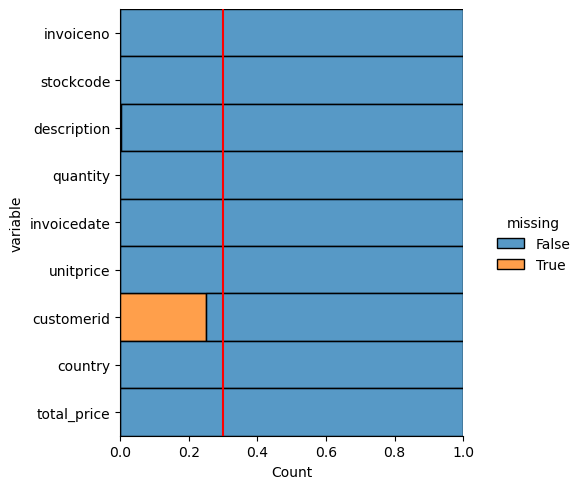

In [78]:
plt.figure(figsize = (5, 5))

sns.displot(
    data = df.isnull().melt(value_name = "missing"),
    y = "variable",
    hue = "missing",
    multiple = "fill",
    height = 5)

plt.axvline(0.3, color = "r");

- Let's assume that the orders which do NOT have customer ID's were not made by the customers already in the dataset because the customers who in fact made some purchases already have ID's.

- So we don't want to assign these orders to those customers because this would alter the insights we draw from the data, hence we drop it.

In [79]:
df.dropna(subset="customerid", inplace=True)
df.shape

(401604, 9)

In [80]:
missing_values(df)

,Missing_Number,Missing_Percent


#### Now let's handle with cancellations and negative values in the given dataset.

In [81]:
final_df = df[(df['unitprice'] > 0) & (df['quantity'] > 0)]

In [82]:
final_df.shape

(392692, 9)

In [83]:
print("There are", df.duplicated(subset=None, keep='first').sum(), "duplicated observations in the dataset.")
print(df.duplicated(subset=None, keep='first').sum(), "Duplicated observations are dropped!")
df.drop_duplicates(keep='first', inplace=True)

There are 0 duplicated observations in the dataset.
0 Duplicated observations are dropped!


###  Exploring the Orders

In [84]:
final_df.columns

Index(['invoiceno', 'stockcode', 'description', 'quantity', 'invoicedate',
       'unitprice', 'customerid', 'country', 'total_price'],
      dtype='object')

In [85]:
cprint("Hot selling products", color="blue")
final_df.groupby(["stockcode", "description"])["quantity"].count().sort_values(ascending=False)

Hot selling products


stockcode  description                        
85123A     WHITE HANGING HEART T-LIGHT HOLDER     2016
22423      REGENCY CAKESTAND 3 TIER               1713
85099B     JUMBO BAG RED RETROSPOT                1615
84879      ASSORTED COLOUR BIRD ORNAMENT          1395
47566      PARTY BUNTING                          1389
                                                  ... 
90055      CRACKED GLAZE EARRINGS BROWN              1
90054      CRACKED GLAZE EARRINGS RED                1
82615      PINK MARSHMALLOW SCARF KNITTING KIT       1
90048      GREEN WITH METAL BAG CHARM                1
23449      SET OF 6 EASTER RAINBOW CHICKS            1
Name: quantity, Length: 3897, dtype: int64

In [86]:
cprint("# Customer wise Hot selling product ", color="blue")
final_df.groupby(["customerid","stockcode", "description"])["quantity"].count().sort_values(ascending=False)

# Customer wise Hot selling product 


customerid  stockcode  description                       
14911.00    C2         CARRIAGE                              84
17841.00    79321      CHILLI LIGHTS                         63
            21975      PACK OF 60 DINOSAUR CAKE CASES        51
            21927      BLUE/CREAM STRIPE CUSHION COVER       49
14911.00    22423      REGENCY CAKESTAND 3 TIER              49
                                                             ..
14552.00    20727      LUNCH BAG  BLACK SKULL.                1
            21034      REX CASH+CARRY JUMBO SHOPPER           1
            21126      SET OF 6 GIRLS CELEBRATION CANDLES     1
            21136      PAINTED METAL PEARS ASSORTED           1
18287.00    85173      SET/6 FROG PRINCE T-LIGHT CANDLES      1
Name: quantity, Length: 268398, dtype: int64

In [87]:
cprint("# Top 5 customers ---> most orders done by a Customer", color="blue")
final_df.groupby(["customerid"])["quantity"].count().sort_values(ascending=False).head()

# Top 5 customers ---> most orders done by a Customer


customerid
17841.00    7676
14911.00    5670
14096.00    5111
12748.00    4412
14606.00    2677
Name: quantity, dtype: int64

In [88]:
cprint("The Average Number of Unqiue Items By Order",'blue')
final_df.groupby(["invoiceno", "stockcode", "description"])["quantity"].mean().sort_values(ascending=False)

The Average Number of Unqiue Items By Order


invoiceno  stockcode  description                      
581483     23843      PAPER CRAFT , LITTLE BIRDIE         80995.00
541431     23166      MEDIUM CERAMIC TOP STORAGE JAR      74215.00
573008     84077      WORLD WAR 2 GLIDERS ASSTD DESIGNS    4800.00
554868     22197      SMALL POPCORN HOLDER                 4300.00
544612     22053      EMPIRE DESIGN ROSETTE                3906.00
                                                            ...   
561894     22921      HERB MARKER CHIVES                      1.00
           22971      QUEENS GUARD COFFEE MUG                 1.00
           22972      CHILDREN'S SPACEBOY MUG                 1.00
569673     23511      EMBROIDERED RIBBON REEL EMILY           1.00
546984     84692      BOX OF 24 COCKTAIL PARASOLS             1.00
Name: quantity, Length: 387843, dtype: float64

### Exploring Customers by Country

1. What's the total revenue per country?

In [89]:
final_df.head(3)

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00


In [90]:
df_country=final_df.groupby("country")["total_price"].sum().sort_values(ascending=False)

In [91]:
fig = px.histogram(df, x = df_country.index, 
                   y = df_country.values, 
                   title = 'Total revenue per Country',
                   labels = dict(x = "Countries", y ="Customer")).update_xaxes(categoryorder="total descending")
fig.show()

2. Number of customers per country

In [92]:
df_customer=final_df.groupby("country")["customerid"].nunique().sort_values(ascending=False)
df_customer

country
United Kingdom          3920
Germany                   94
France                    87
Spain                     30
Belgium                   25
Switzerland               21
Portugal                  19
Italy                     14
Finland                   12
Austria                   11
Norway                    10
Netherlands                9
Australia                  9
Denmark                    9
Channel Islands            9
Cyprus                     8
Sweden                     8
Japan                      8
Poland                     6
USA                        4
Canada                     4
Unspecified                4
Greece                     4
EIRE                       3
Israel                     3
Malta                      2
United Arab Emirates       2
Bahrain                    2
Czech Republic             1
Lithuania                  1
Lebanon                    1
RSA                        1
Saudi Arabia               1
Singapore                  1
Icelan

In [93]:
df_customer.sum()

4346

In [94]:
final_df["customerid"].nunique()

4338

In [95]:
fig = px.histogram(df, x = df_customer.index, 
                   y = df_customer.values, 
                   title = 'Total customer per Country',
                   labels = dict(x = "Countries", y ="Customer")).update_xaxes(categoryorder="total descending")
fig.show()

In [96]:
df_customer_w_UK = df_customer.iloc[1:]

In [97]:
df_customer_w_UK

country
Germany                 94
France                  87
Spain                   30
Belgium                 25
Switzerland             21
Portugal                19
Italy                   14
Finland                 12
Austria                 11
Norway                  10
Netherlands              9
Australia                9
Denmark                  9
Channel Islands          9
Cyprus                   8
Sweden                   8
Japan                    8
Poland                   6
USA                      4
Canada                   4
Unspecified              4
Greece                   4
EIRE                     3
Israel                   3
Malta                    2
United Arab Emirates     2
Bahrain                  2
Czech Republic           1
Lithuania                1
Lebanon                  1
RSA                      1
Saudi Arabia             1
Singapore                1
Iceland                  1
Brazil                   1
European Community       1
Name: customerid, dt

In [98]:
fig = px.histogram(df, x = df_customer_w_UK.index, 
                   y = df_customer_w_UK.values, 
                   title = 'Total customer per Country without UK',
                   labels = dict(x = "Countries", y ="Customer")).update_xaxes(categoryorder="total descending")
fig.show()

In [99]:
fig = px.treemap(df_customer, path=[df_customer.index], values='customerid', width=950, height=600)
fig.update_layout(title_text='Customers By Countries',
                  title_x=0.5, title_font=dict(size=20)
                  )
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.show()

 - The UK not only has the most sales revenue, but also the most customers. Since the majority of this dataset contains orders from the UK, we can explore the UK market further analysis by finding out what products the customers buy together and any other buying behaviors to improve our sales and targeting strategy.

In [100]:
df_uk = final_df[final_df["country"]=="United Kingdom"]
df_uk

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34
...,...,...,...,...,...,...,...,...,...
541889,581585,22466,FAIRY TALE COTTAGE NIGHT LIGHT,12,2011-12-09 12:31:00,1.95,15804.00,United Kingdom,23.40
541890,581586,22061,LARGE CAKE STAND HANGING STRAWBERY,8,2011-12-09 12:49:00,2.95,13113.00,United Kingdom,23.60
541891,581586,23275,SET OF 3 HANGING OWLS OLLIE BEAK,24,2011-12-09 12:49:00,1.25,13113.00,United Kingdom,30.00
541892,581586,21217,RED RETROSPOT ROUND CAKE TINS,24,2011-12-09 12:49:00,8.95,13113.00,United Kingdom,214.80


In [101]:
df_uk.shape

(349203, 9)

-  What are the most popular products that are bought in the UK?

In [102]:
df_uk.groupby(["stockcode", "description"])["quantity"].sum().sort_values(ascending=False).head(10)

stockcode  description                       
23843      PAPER CRAFT , LITTLE BIRDIE           80995
23166      MEDIUM CERAMIC TOP STORAGE JAR        76919
84077      WORLD WAR 2 GLIDERS ASSTD DESIGNS     49086
85099B     JUMBO BAG RED RETROSPOT               41878
85123A     WHITE HANGING HEART T-LIGHT HOLDER    34630
84879      ASSORTED COLOUR BIRD ORNAMENT         32628
22197      POPCORN HOLDER                        28923
22616      PACK OF 12 LONDON TISSUES             24321
17003      BROCADE RING PURSE                    22675
21212      PACK OF 72 RETROSPOT CAKE CASES       22442
Name: quantity, dtype: int64

 - We will continue analyzing the UK transactions with customer segmentation.

# RFM ANALYSIS

In the age of the internet and e-commerce, companies that do not expand their businesses online or utilize digital tools to reach their customers will run into issues like scalability and a lack of digital precsence. An important marketing strategy e-commerce businesses use for analyzing and predicting customer value is customer segmentation. Customer data is used to sort customers into group based on their behaviors and preferences.

RFM (Recency, Frequency, Monetary) Analysis is a customer segmentation technique for analyzing customer value based on past buying behavior. RFM analysis was first used by the direct mail industry more than four decades ago, yet it is still an effective way to optimize your marketing.

Our goal in this Notebook is to cluster the customers in our data set to:

- Recognize who are our most valuable customers
- Increase revenue
- Increase customer retention
- Learn more about the trends and behaviors of our customers
- Define customers that are at risk


We will start with RFM Analysis and then compliment our findings with predictive analysis using K-Means Clustering Algorithms.

- RECENCY (R): Time since last purchase
- FREQUENCY (F): Total number of purchases
- MONETARY VALUE (M): Total monetary value

Benefits of RFM Analysis

Increased customer retention
Increased response rate
Increased conversion rate
Increased revenue
RFM Analysis answers the following questions:

Who are our best customers?
Who has the potential to be converted into more profitable customers?
Which customers do we need to retain?
Which group of customers is most likely to respond to our marketing campaign?



### Importing Related Libraries

In [103]:
import datetime as dt
from datetime import datetime
from datetime import timedelta

In [104]:
df_uk.head()

,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34


In [105]:
first_looking(df_uk)
duplicate_values(df_uk)

Shape:(349203, 9)
****************************************************************************************************
Info:

<class 'pandas.core.frame.DataFrame'>
Int64Index: 349203 entries, 0 to 541893
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   invoiceno    349203 non-null  object        
 1   stockcode    349203 non-null  object        
 2   description  349203 non-null  object        
 3   quantity     349203 non-null  int64         
 4   invoicedate  349203 non-null  datetime64[ns]
 5   unitprice    349203 non-null  float64       
 6   customerid   349203 non-null  float64       
 7   country      349203 non-null  object        
 8   total_price  349203 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(1), object(4)
memory usage: 26.6+ MB
None
****************************************************************************************************
Number of Uniques:
invoice

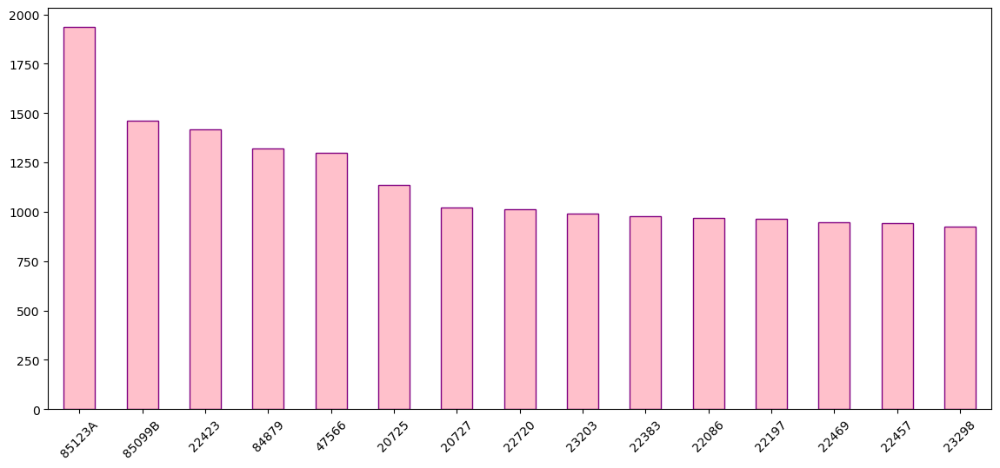

In [106]:
# Top 15 most purchased products.

df_uk["stockcode"].value_counts().head(15).plot(kind="bar", width=0.5, color='pink', edgecolor='purple', figsize=(14, 6))
plt.xticks(rotation=45);

In [107]:
cprint("Top 10 Demanded Products By Quantity",'blue')  #iplot--> interactive plot
df_uk.groupby("stockcode")['quantity'].sum().sort_values(ascending=False)[:10].iplot(kind="bar", width=0.5, color='cyan');

Top 10 Demanded Products By Quantity


## Calculating Recency

Recency: Days since last purchase

To calculate the recency values, follow these steps in order:

1. To calculate recency, we need to choose a date as a point of reference to evaluate how many days ago was the customer's last purchase.
2. Create a new column called Date which contains the invoice date without the timestamp.
3. Group by CustomerID and check the last date of purchase.
4. Calculate the days since last purchase.
5. Drop Last_Purchase_Date since we don't need it anymore.
6. Plot RFM distributions.

In [108]:
df_uk=df_uk.reset_index()

In [109]:
df_uk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 349203 entries, 0 to 349202
Data columns (total 10 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   index        349203 non-null  int64         
 1   invoiceno    349203 non-null  object        
 2   stockcode    349203 non-null  object        
 3   description  349203 non-null  object        
 4   quantity     349203 non-null  int64         
 5   invoicedate  349203 non-null  datetime64[ns]
 6   unitprice    349203 non-null  float64       
 7   customerid   349203 non-null  float64       
 8   country      349203 non-null  object        
 9   total_price  349203 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(2), object(4)
memory usage: 26.6+ MB


In [110]:
max(df_uk["invoicedate"]), df_uk["invoicedate"].min()

(Timestamp('2011-12-09 12:49:00'), Timestamp('2010-12-01 08:26:00'))

In [111]:
# Lets extract the given invoice date to last purchase date

In [112]:
df_uk["last_purchase_date"] = df_uk.groupby("customerid")["invoicedate"].transform(max)

In [113]:
df_uk["last_purchase_date"]=df_uk["last_purchase_date"].dt.date

In [114]:
df_uk

,index,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price,last_purchase_date
0,0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30,2010-12-02
1,1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02
2,2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00,2010-12-02
3,3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02
4,4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02
...,...,...,...,...,...,...,...,...,...,...,...
349198,541889,581585,22466,FAIRY TALE COTTAGE NIGHT LIGHT,12,2011-12-09 12:31:00,1.95,15804.00,United Kingdom,23.40,2011-12-09
349199,541890,581586,22061,LARGE CAKE STAND HANGING STRAWBERY,8,2011-12-09 12:49:00,2.95,13113.00,United Kingdom,23.60,2011-12-09
349200,541891,581586,23275,SET OF 3 HANGING OWLS OLLIE BEAK,24,2011-12-09 12:49:00,1.25,13113.00,United Kingdom,30.00,2011-12-09
349201,541892,581586,21217,RED RETROSPOT ROUND CAKE TINS,24,2011-12-09 12:49:00,8.95,13113.00,United Kingdom,214.80,2011-12-09


In [115]:
df_uk['last_purchase_date'] = pd.to_datetime(df_uk['last_purchase_date'])

In [116]:
df_uk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 349203 entries, 0 to 349202
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   index               349203 non-null  int64         
 1   invoiceno           349203 non-null  object        
 2   stockcode           349203 non-null  object        
 3   description         349203 non-null  object        
 4   quantity            349203 non-null  int64         
 5   invoicedate         349203 non-null  datetime64[ns]
 6   unitprice           349203 non-null  float64       
 7   customerid          349203 non-null  float64       
 8   country             349203 non-null  object        
 9   total_price         349203 non-null  float64       
 10  last_purchase_date  349203 non-null  datetime64[ns]
dtypes: datetime64[ns](2), float64(3), int64(2), object(4)
memory usage: 29.3+ MB


In [117]:
# lets keep a reference date as max date + 7 days

In [118]:
df_uk["reference_date"] = df_uk["invoicedate"].max() + timedelta(days=7)

In [119]:
df_uk["reference_date"]=df_uk["reference_date"].dt.date

In [120]:
df_uk

,index,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price,last_purchase_date,reference_date
0,0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30,2010-12-02,2011-12-16
1,1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02,2011-12-16
2,2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00,2010-12-02,2011-12-16
3,3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02,2011-12-16
4,4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02,2011-12-16
...,...,...,...,...,...,...,...,...,...,...,...,...
349198,541889,581585,22466,FAIRY TALE COTTAGE NIGHT LIGHT,12,2011-12-09 12:31:00,1.95,15804.00,United Kingdom,23.40,2011-12-09,2011-12-16
349199,541890,581586,22061,LARGE CAKE STAND HANGING STRAWBERY,8,2011-12-09 12:49:00,2.95,13113.00,United Kingdom,23.60,2011-12-09,2011-12-16
349200,541891,581586,23275,SET OF 3 HANGING OWLS OLLIE BEAK,24,2011-12-09 12:49:00,1.25,13113.00,United Kingdom,30.00,2011-12-09,2011-12-16
349201,541892,581586,21217,RED RETROSPOT ROUND CAKE TINS,24,2011-12-09 12:49:00,8.95,13113.00,United Kingdom,214.80,2011-12-09,2011-12-16


In [121]:
df_uk['date'] = pd.to_datetime(df_uk['invoicedate']).dt.date

In [122]:
df_uk

,index,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price,last_purchase_date,reference_date,date
0,0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30,2010-12-02,2011-12-16,2010-12-01
1,1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02,2011-12-16,2010-12-01
2,2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00,2010-12-02,2011-12-16,2010-12-01
3,3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02,2011-12-16,2010-12-01
4,4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2010-12-02,2011-12-16,2010-12-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
349198,541889,581585,22466,FAIRY TALE COTTAGE NIGHT LIGHT,12,2011-12-09 12:31:00,1.95,15804.00,United Kingdom,23.40,2011-12-09,2011-12-16,2011-12-09
349199,541890,581586,22061,LARGE CAKE STAND HANGING STRAWBERY,8,2011-12-09 12:49:00,2.95,13113.00,United Kingdom,23.60,2011-12-09,2011-12-16,2011-12-09
349200,541891,581586,23275,SET OF 3 HANGING OWLS OLLIE BEAK,24,2011-12-09 12:49:00,1.25,13113.00,United Kingdom,30.00,2011-12-09,2011-12-16,2011-12-09
349201,541892,581586,21217,RED RETROSPOT ROUND CAKE TINS,24,2011-12-09 12:49:00,8.95,13113.00,United Kingdom,214.80,2011-12-09,2011-12-16,2011-12-09


### Check the last date of purchace each customer

In [123]:
customer_recency = pd.DataFrame(df_uk.groupby(["customerid"],as_index=False)["date"].max())


In [124]:
customer_recency

,customerid,date
0,12346.00,2011-01-18
1,12747.00,2011-12-07
2,12748.00,2011-12-09
3,12749.00,2011-12-06
4,12820.00,2011-12-06
...,...,...
3915,18280.00,2011-03-07
3916,18281.00,2011-06-12
3917,18282.00,2011-12-02
3918,18283.00,2011-12-06


In [125]:
df_uk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 349203 entries, 0 to 349202
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   index               349203 non-null  int64         
 1   invoiceno           349203 non-null  object        
 2   stockcode           349203 non-null  object        
 3   description         349203 non-null  object        
 4   quantity            349203 non-null  int64         
 5   invoicedate         349203 non-null  datetime64[ns]
 6   unitprice           349203 non-null  float64       
 7   customerid          349203 non-null  float64       
 8   country             349203 non-null  object        
 9   total_price         349203 non-null  float64       
 10  last_purchase_date  349203 non-null  datetime64[ns]
 11  reference_date      349203 non-null  object        
 12  date                349203 non-null  object        
dtypes: datetime64[ns](2), float64

In [126]:
df_uk["reference_date"]=pd.to_datetime(df_uk["reference_date"])

In [127]:
df_uk["customer_recency"] = df_uk["reference_date"] - df_uk["last_purchase_date"]
df_uk[["customerid", 'last_purchase_date', "reference_date", "customer_recency","country"]].head()

,customerid,last_purchase_date,reference_date,customer_recency,country
0,17850.00,2010-12-02,2011-12-16,379 days,United Kingdom
1,17850.00,2010-12-02,2011-12-16,379 days,United Kingdom
2,17850.00,2010-12-02,2011-12-16,379 days,United Kingdom
3,17850.00,2010-12-02,2011-12-16,379 days,United Kingdom
4,17850.00,2010-12-02,2011-12-16,379 days,United Kingdom


In [128]:
df_uk['recency2'] = pd.to_numeric(df_uk['customer_recency'].dt.days.astype('int64'))
df_uk[["customerid", 'last_purchase_date', "reference_date", "customer_recency", 'recency2']]

,customerid,last_purchase_date,reference_date,customer_recency,recency2
0,17850.00,2010-12-02,2011-12-16,379 days,379
1,17850.00,2010-12-02,2011-12-16,379 days,379
2,17850.00,2010-12-02,2011-12-16,379 days,379
3,17850.00,2010-12-02,2011-12-16,379 days,379
4,17850.00,2010-12-02,2011-12-16,379 days,379
...,...,...,...,...,...
349198,15804.00,2011-12-09,2011-12-16,7 days,7
349199,13113.00,2011-12-09,2011-12-16,7 days,7
349200,13113.00,2011-12-09,2011-12-16,7 days,7
349201,13113.00,2011-12-09,2011-12-16,7 days,7


In [129]:
customer_recency = df_uk.groupby("customerid",as_index=False)["recency2"].mean()
customer_recency.rename(columns={'recency2':'Recency'}, inplace=True)
customer_recency.sort_values(by='Recency', ascending=False).head()

,customerid,Recency
3452,17643.00,380.00
1800,15350.00,380.00
2220,15922.00,380.00
2307,16048.00,380.00
1004,14237.00,380.00


In [130]:
df_uk.drop(['last_purchase_date'], axis = 1, inplace=True)
df_uk.head(3)

,index,invoiceno,stockcode,description,quantity,invoicedate,unitprice,customerid,country,total_price,reference_date,date,customer_recency,recency2
0,0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.00,United Kingdom,15.30,2011-12-16,2010-12-01,379 days,379
1,1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.00,United Kingdom,20.34,2011-12-16,2010-12-01,379 days,379
2,2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.00,United Kingdom,22.00,2011-12-16,2010-12-01,379 days,379


### Checking the recency of the customer ID, keeping the refeernce to last 3 months

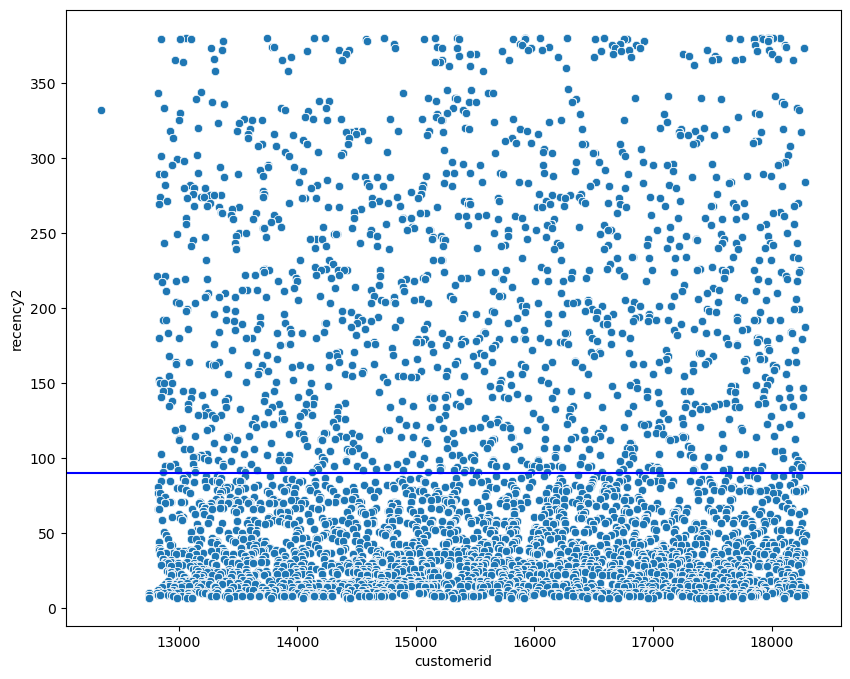

In [131]:
%matplotlib inline

plt.figure(figsize=(10, 8))
graph = sns.scatterplot(data=df_uk, x="customerid", y="recency2")
graph.axhline(90, color="blue")
plt.show();

In [132]:
df_uk.groupby("customerid",as_index=False)["recency2"].max()

,customerid,recency2
0,12346.00,332
1,12747.00,9
2,12748.00,7
3,12749.00,10
4,12820.00,10
...,...,...
3915,18280.00,284
3916,18281.00,187
3917,18282.00,14
3918,18283.00,10


In [133]:
px.histogram(data_frame=df_uk.groupby("customerid",as_index=False)["recency2"].max(), x="recency2", nbins=70)


### Since the data distribution is right skewed , most of the customers has purchase history of less than 90 days

## Calculating Frequency

### Frequency: Number of purchases
To calculate how many times a customer purchased something, we need to count how many invoices each customer has.

In [134]:
customer_frequency = df_uk.groupby('customerid', as_index=False)['invoiceno'].nunique()
customer_frequency.rename(columns={'invoiceno':'Frequency'}, inplace=True)
customer_frequency.sort_values(by='Frequency', ascending=False)

,customerid,Frequency
2,12748.00,209
3593,17841.00,124
191,13089.00,97
1267,14606.00,93
1771,15311.00,91
...,...,...
953,14165.00,1
955,14171.00,1
957,14174.00,1
2576,16415.00,1


### Plotting the frequency distribution

In [135]:
fig = px.scatter(customer_frequency, x="customerid", y="Frequency")
fig.show()

<AxesSubplot:xlabel='Frequency'>

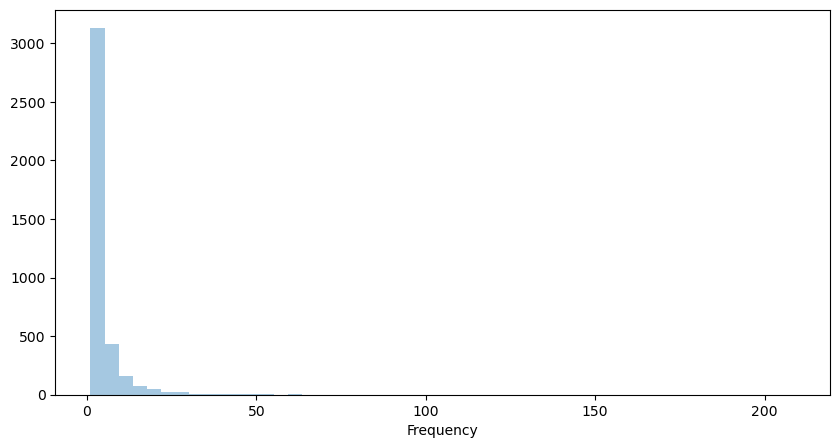

In [136]:
plt.figure(figsize=(10,5))
sns.distplot(customer_frequency["Frequency"], kde=False)

### it is very clear from the above plots that frequency of purchase of products lies below 30 for most of the customers.

## Calculating Monetary Values

### Monetary: Total amount of money spent
- The monetary value is calculated by adding together the cost of the customers' purchases.

1. Calculate sum total cost by customers and named "Monetary"

In [137]:
customer_monetary = df_uk.groupby('customerid', as_index=False)['total_price'].sum()
customer_monetary.rename(columns={'total_price':'Monetary'}, inplace=True)
customer_monetary.sort_values(by='Monetary', ascending=False).head()

,customerid,Monetary
3783,18102.00,259657.30
3314,17450.00,194390.79
2598,16446.00,168472.50
3356,17511.00,91062.38
2294,16029.00,80850.84


### Plotting the Monetary distributions

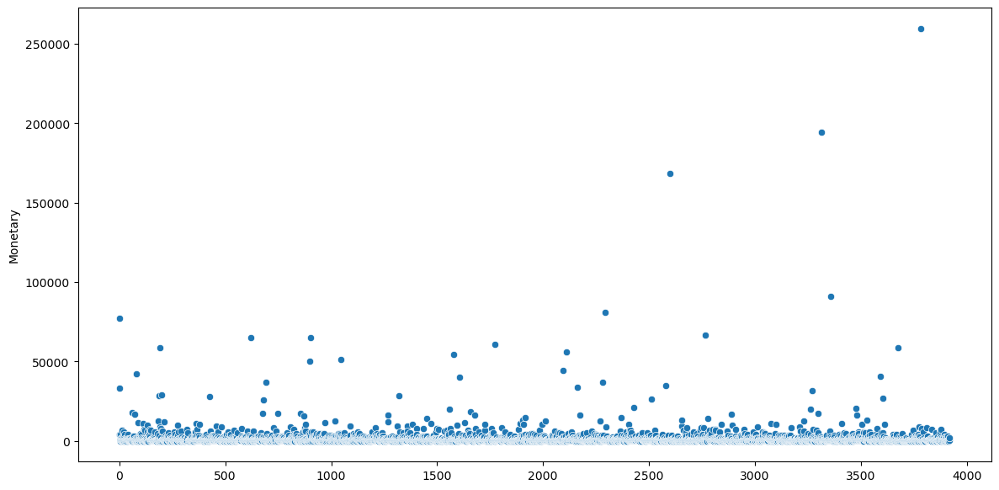

In [138]:
plt.figure(figsize=(14, 7))
sns.scatterplot(data=customer_monetary.Monetary);

In [139]:
fig = px.histogram(customer_monetary, x="Monetary", nbins=100)
fig.show()

 ### Creating RFM Table

#### For creating the RFM Table, we need to merge the recency, frequency and monetary dataframes.

In [140]:
customer_rfm = pd.merge(pd.merge(customer_recency, customer_frequency, on='customerid'), customer_monetary, on='customerid')
customer_rfm.head()

,customerid,Recency,Frequency,Monetary
0,12346.00,332.00,1,77183.60
1,12747.00,9.00,11,4196.01
2,12748.00,7.00,209,33053.19
3,12749.00,10.00,5,4090.88
4,12820.00,10.00,4,942.34


## CUSTOMER SEGMENTATION WITH RFM SCORES

- Businesses have this ever-lasting urge to understand their customers. The better you understand the customer, the better you serve them, and the higher the financial gain you receive from that customer. Since the dawn of trade, this process of understanding customers for a strategic gain has been there practiced and this task is known majorly as Customer Segmentation. Well as the name suggests, Customer Segmentation could segment customers according to their precise needs. Some of the common ways of segmenting customers are based on their Recency-Frequency-Monatory values, their demographics like gender, region, country, etc, and some of their business-crafted scores. You will use Recency-Frequency-Monatory values for this case.

- In this section, you will create an RFM Segmentation Table where you segment your customers by using the RFM table. For example, you can label the best customer as "Big Spenders" and the lost customer as "Lost Customer".

### Calculating RFM Scoring

- The simplest way to create customer segments from an RFM model is by using Quartiles. We will assign a score from 1 to 4 to each category (Recency, Frequency, and Monetary) with 4 being the highest/best value. The final RFM score is calculated by combining all RFM values. For Customer Segmentation, you will use the customer_rfm data set resulting from the RFM analysis.

<b>Note</b>: Data can be assigned into more groups for better granularity, but we will use 4 in this case.

#### 1. Dividing the customer_rfm into quarters

In [141]:
customer_rfm.describe()

,customerid,Recency,Frequency,Monetary
count,3920.00,3920.00,3920.00,3920.00
mean,15562.06,98.74,4.25,1858.42
std,1576.59,99.53,7.20,7478.63
min,12346.00,7.00,1.00,3.75
25%,14208.75,24.00,1.00,298.19
50%,15569.50,57.00,2.00,644.97
75%,16913.25,149.00,5.00,1571.28
max,18287.00,380.00,209.00,259657.30


#### 2. Creating the RFM Segmentation Table

- Create two functions, one for Recency and one for Frequency and Monetary. For Recency, customers in the first quarter should be scored as 4, this represents the highest Recency value. Conversely, for Frequency and Monetary, customers in the last quarter should be scored as 4, representing the highest Frequency and Monetary values.

- Score customers from 1 to 4 by applying the functions you have created. Also create separate score column for each value.

In [142]:
def recency_scoring(rfm):
    if rfm.Recency <= 24.0:
        recency_score = 4
    elif rfm.Recency <= 57.0:
        recency_score = 3
    elif rfm.Recency <= 149.0:
        recency_score = 2
    else:
        recency_score = 1
    return recency_score

In [143]:
customer_rfm["Recency_score"] = customer_rfm.apply(recency_scoring, axis=1)

In [144]:
customer_rfm

,customerid,Recency,Frequency,Monetary,Recency_score
0,12346.00,332.00,1,77183.60,1
1,12747.00,9.00,11,4196.01,4
2,12748.00,7.00,209,33053.19,4
3,12749.00,10.00,5,4090.88,4
4,12820.00,10.00,4,942.34,4
...,...,...,...,...,...
3915,18280.00,284.00,1,180.60,1
3916,18281.00,187.00,1,80.82,1
3917,18282.00,14.00,2,178.05,4
3918,18283.00,10.00,16,2045.53,4


In [145]:
fig = px.pie(customer_rfm, values = customer_rfm['Recency_score'].value_counts(), 
             names = (customer_rfm["Recency_score"].value_counts()).index, 
             title = 'Recency Score Distribution')
fig.show()

In [146]:
customer_rfm['Recency_score'].value_counts()

4    1003
1     979
2     969
3     969
Name: Recency_score, dtype: int64

In [147]:
def frequency_scoring(rfm):
    if rfm.Frequency >= 10.0:
        frequency_score = 4
    elif rfm.Frequency >= 5.0:
        frequency_score = 3
    elif rfm.Frequency >= 2.0:
        frequency_score = 2
    else:
        frequency_score = 1
    return frequency_score

customer_rfm['Frequency_Score'] = customer_rfm.apply(frequency_scoring, axis=1)
customer_rfm.sample(10)

,customerid,Recency,Frequency,Monetary,Recency_score,Frequency_Score
885,14073.00,39.00,1,151.04,3,1
2478,16278.00,107.00,1,566.38,2,1
1399,14793.00,28.00,1,228.99,3,1
3667,17937.00,15.00,7,4301.22,4,3
2129,15799.00,82.00,3,884.14,2,2
1745,15272.00,64.00,2,721.94,2,2
3553,17772.00,17.00,2,173.45,4,2
2666,16542.00,60.00,1,119.62,2,1
2826,16761.00,103.00,1,316.62,2,1
2602,16450.00,156.00,1,311.92,1,1


In [148]:
fig = px.pie(df, values = customer_rfm['Frequency_Score'].value_counts(), 
             names = (customer_rfm["Frequency_Score"].value_counts()).index, 
             title = 'Frequency Score Distribution')
fig.show()

In [149]:
def monetary_scoring(rfm):
    if rfm.Monetary >= 1571.0:
        monetary_score = 4
    elif rfm.Monetary >= 645.0:
        monetary_score = 3
    elif rfm.Monetary >= 298.0:
        monetary_score = 2
    else:
        monetary_score = 1
    return monetary_score

customer_rfm['Monetary_Score'] = customer_rfm.apply(monetary_scoring, axis=1)
customer_rfm.sample(10)

,customerid,Recency,Frequency,Monetary,Recency_score,Frequency_Score,Monetary_Score
1815,15372.00,144.00,1,2007.40,2,1,4
427,13414.00,140.00,3,1390.50,2,2,3
3755,18066.00,82.00,1,318.00,2,1,2
2147,15820.00,326.00,1,206.98,1,1,1
1574,15054.00,19.00,2,302.10,4,2,2
237,13147.00,17.00,4,712.80,4,2,3
1116,14407.00,114.00,6,2157.73,2,3,4
3376,17535.00,287.00,1,164.40,1,1,1
327,13272.00,38.00,2,276.56,3,2,1
2264,15990.00,51.00,2,792.11,3,2,3


In [150]:
fig = px.pie(customer_rfm, values=customer_rfm["Monetary_Score"].value_counts(),
            names = customer_rfm["Monetary_Score"].value_counts().index ,
            title = 'Monetary Score Distribution')
fig.show()

### 3. Now combine the scores for segmentation.

In [151]:
def rfm_score(df):
    return (str(int(df["Recency_score"])) + str(int(df["Frequency_Score"])) + str(int(df["Monetary_Score"])))

In [152]:
customer_rfm['Customer_RFM_Score'] = customer_rfm.apply(rfm_score, axis=1)

In [153]:
customer_rfm

,customerid,Recency,Frequency,Monetary,Recency_score,Frequency_Score,Monetary_Score,Customer_RFM_Score
0,12346.00,332.00,1,77183.60,1,1,4,114
1,12747.00,9.00,11,4196.01,4,4,4,444
2,12748.00,7.00,209,33053.19,4,4,4,444
3,12749.00,10.00,5,4090.88,4,3,4,434
4,12820.00,10.00,4,942.34,4,2,3,423
...,...,...,...,...,...,...,...,...
3915,18280.00,284.00,1,180.60,1,1,1,111
3916,18281.00,187.00,1,80.82,1,1,1,111
3917,18282.00,14.00,2,178.05,4,2,1,421
3918,18283.00,10.00,16,2045.53,4,4,4,444


In [154]:
fig = px.histogram(customer_rfm, x = customer_rfm['Customer_RFM_Score'].value_counts().index, 
                   y = customer_rfm['Customer_RFM_Score'].value_counts().values, 
                   title = 'Customer RFM Score Distribution',
                   labels = dict(x = "Customer_RFM_Score", y ="counts"))
fig.show()

### 4. Define rfm_level function that tags customers by using RFM_Scrores and Create a new variable RFM_Label.

In [155]:
customer_rfm['RFM_Label'] = customer_rfm['Recency_score'] + customer_rfm['Frequency_Score'] + customer_rfm['Monetary_Score']

customer_rfm.sample(8)

,customerid,Recency,Frequency,Monetary,Recency_score,Frequency_Score,Monetary_Score,Customer_RFM_Score,RFM_Label
1424,14828.00,203.00,3,2139.76,1,2,4,124,7
1091,14367.00,15.00,16,9227.82,4,4,4,444,12
2555,16387.00,329.00,1,94.36,1,1,1,111,3
2461,16250.00,268.00,2,389.44,1,2,2,122,5
3437,17621.00,28.00,3,1379.90,3,2,3,323,8
3866,18216.00,38.00,1,481.75,3,1,2,312,6
2739,16647.00,176.00,2,214.06,1,2,1,121,4
2696,16587.00,239.00,1,225.15,1,1,1,111,3


In [156]:
fig = px.pie(df, values = customer_rfm['RFM_Label'].value_counts(), 
             names = (customer_rfm["RFM_Label"].value_counts()).index, 
             title = 'RFM Label Distribution')
fig.show()

In [157]:
segments = {'Customer_Segment':['Champion', 
                                'Top Loyal Customer', 
                                'Loyal Customer', 
                                'Top Recent Customer', 
                                'Recent Customer', 
                                'Top Customer Needed Attention', 
                                'Customer Needed Attention', 
                                'Top Lost Customer', 
                                'Lost Customer'],
            'RFM':['(3|4)-(4)-(4)', 
                   '(3)-(1|2|3|4)-(3|4)', 
                   '(3)-(1|2|3|4)-(1|2)', 
                   '(4)-(1|2|3|4)-(3|4)', 
                   '(4)-(1|2|3|4)-(1|2)',
                   '(2|3)-(1|2|3|4)-(3|4)', 
                   '(2|3)-(1|2|3|4)-(1|2)',
                   '(1)-(1|2|3|4)-(3|4)', 
                   '(1)-(1|2|3|4)-(1|2)',]}

pd.DataFrame(segments)

,Customer_Segment,RFM
0,Champion,(3|4)-(4)-(4)
1,Top Loyal Customer,(3)-(1|2|3|4)-(3|4)
2,Loyal Customer,(3)-(1|2|3|4)-(1|2)
3,Top Recent Customer,(4)-(1|2|3|4)-(3|4)
4,Recent Customer,(4)-(1|2|3|4)-(1|2)
5,Top Customer Needed Attention,(2|3)-(1|2|3|4)-(3|4)
6,Customer Needed Attention,(2|3)-(1|2|3|4)-(1|2)
7,Top Lost Customer,(1)-(1|2|3|4)-(3|4)
8,Lost Customer,(1)-(1|2|3|4)-(1|2)


In [158]:
def categorizer(rfm):
    
    if (rfm[0] in ['4']) & (rfm[1] in ['4']) & (rfm[2] in ['4']):
        rfm= "champion"
        
    elif (rfm[0] in ['3']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['3', '4']):
        rfm = 'Top Loyal Customer'
        
    elif (rfm[0] in ['3']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['1', '2']):
        rfm = 'Loyal Customer'
    
    elif (rfm[0] in ['4']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['3', '4']):
        rfm = 'Top Recent Customer'
    
    elif (rfm[0] in ['4']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['1', '2']):
        rfm = 'Recent Customer'
    
    elif (rfm[0] in ['2', '3']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['3', '4']):
        rfm = 'Top Customer Needed Attention'    
   
    elif (rfm[0] in ['2', '3']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['1', '2']):
        rfm = 'Customer Needed Attention'
    
    elif (rfm[0] in ['1']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['3', '4']):
        rfm = 'Top Lost Customer'
                
    elif (rfm[0] in ['1']) & (rfm[1] in ['1', '2', '3', '4']) & (rfm[2] in ['1', '2']):
        rfm = 'Lost Customer'
    
    return rfm  

In [159]:
customer_rfm['Customer_Category'] = customer_rfm["Customer_RFM_Score"].apply(categorizer)

In [160]:
segmentation=customer_rfm["Customer_Category"].value_counts(dropna=False).sort_values(ascending=False)
segmentation


Lost Customer                    806
Top Loyal Customer               561
Customer Needed Attention        512
Top Recent Customer              508
Top Customer Needed Attention    457
Loyal Customer                   408
champion                         261
Recent Customer                  234
Top Lost Customer                173
Name: Customer_Category, dtype: int64

- <B>Champions</B> are your best customers, who bought most recently, most often, and are heavy spenders. 
    - Reward these customers. They can become early adopters for new products and will help promote your brand.
    
    
- <B>Loyal and Top Loyal customers</B> are your recent customers with average frequency and who spent a good amount. 
    - Offer membership or loyalty programs or recommend related products to upsell them and help them become your  Champions.
    
    
    
- <B>Top Recent Customer and Recent Customers</B> are new Customers
    - Start building relationships with these customers by providing onboarding support and special offers to increase their visits.
    
    
    
- <B>Top Customer Needed Attention and Customer Needed Attention</B> are the customers who used to visit and purchase quite often, but haven’t been visiting recently. 
    - Bring them back with relevant promotions, and run surveys to find out what went wrong and avoid losing them to a competitor.
    
    

- <B>Top Lost Customer and Lost Customers</B> are, who purchased often and spent big amounts, but haven’t purchased recently.
    - Send them personalized reactivation campaigns to reconnect, and offer renewals and helpful products to encourage another purchase.

In [161]:
fig = px.histogram(customer_rfm, 
                   x = customer_rfm['Customer_Category'].value_counts().index, 
                   y = customer_rfm['Customer_Category'].value_counts().values, 
                   title = 'Customer Category Distribution',
                   labels = dict(x = "Customer_Category", y ="counts"))
fig.show()

In [162]:
fig = px.pie(customer_rfm, 
             values = customer_rfm["Customer_Category"].value_counts(),
             names = (customer_rfm["Customer_Category"].value_counts()).index, 
             title = 'Customer Category Distribution')
fig.show()

In [163]:
segmentation = pd.DataFrame(segmentation).reset_index()

In [164]:
segmentation.rename(columns={'index':'Customer Category', 'Customer_Category':'The Number Of Customer'}, inplace=True)
segmentation

,Customer Category,The Number Of Customer
0,Lost Customer,806
1,Top Loyal Customer,561
2,Customer Needed Attention,512
3,Top Recent Customer,508
4,Top Customer Needed Attention,457
5,Loyal Customer,408
6,champion,261
7,Recent Customer,234
8,Top Lost Customer,173


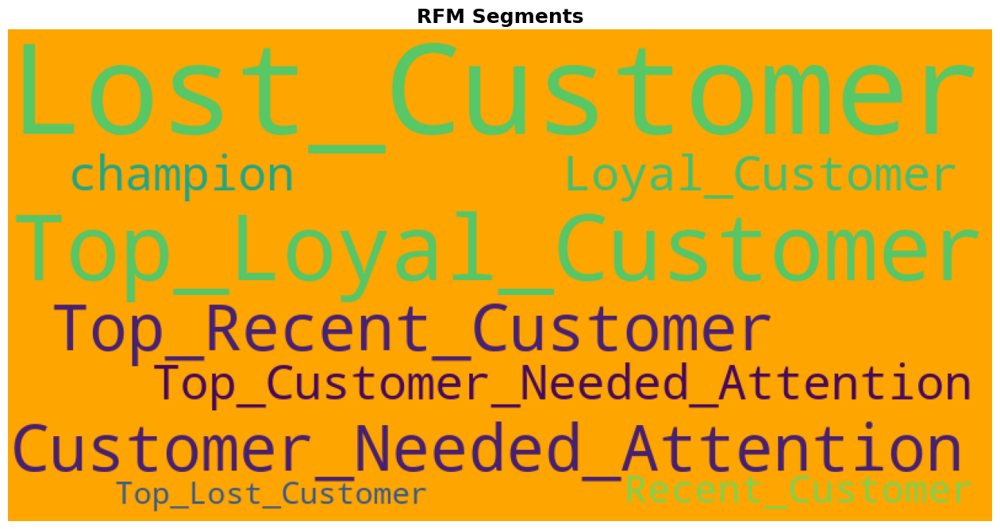

In [165]:
segment_text = segmentation["Customer Category"].str.split(" ").str.join("_")
all_segments = " ".join(segment_text)

wc = WordCloud(background_color="orange", 
               #max_words=250, 
               max_font_size=256, 
               random_state=42,
               width=800, height=400)
wc.generate(all_segments)
plt.figure(figsize = (16, 15))
plt.imshow(wc)
plt.title("RFM Segments", fontsize=18, fontweight="bold")
plt.axis('off')
plt.show()

# APPLYING K-MEANS CLUSTERING

In [166]:
customer_rfm.corr()

,customerid,Recency,Frequency,Monetary,Recency_score,Frequency_Score,Monetary_Score,RFM_Label
customerid,1.00,0.01,-0.02,0.00,0.00,-0.00,-0.05,-0.02
Recency,0.01,1.00,-0.27,-0.13,-0.86,-0.48,-0.44,-0.71
Frequency,-0.02,-0.27,1.00,0.51,0.35,0.62,0.45,0.55
Monetary,0.00,-0.13,0.51,1.00,0.17,0.30,0.26,0.29
Recency_score,0.00,-0.86,0.35,0.17,1.00,0.53,0.46,0.79
Frequency_Score,-0.00,-0.48,0.62,0.30,0.53,1.00,0.75,0.88
Monetary_Score,-0.05,-0.44,0.45,0.26,0.46,0.75,1.00,0.87
RFM_Label,-0.02,-0.71,0.55,0.29,0.79,0.88,0.87,1.00


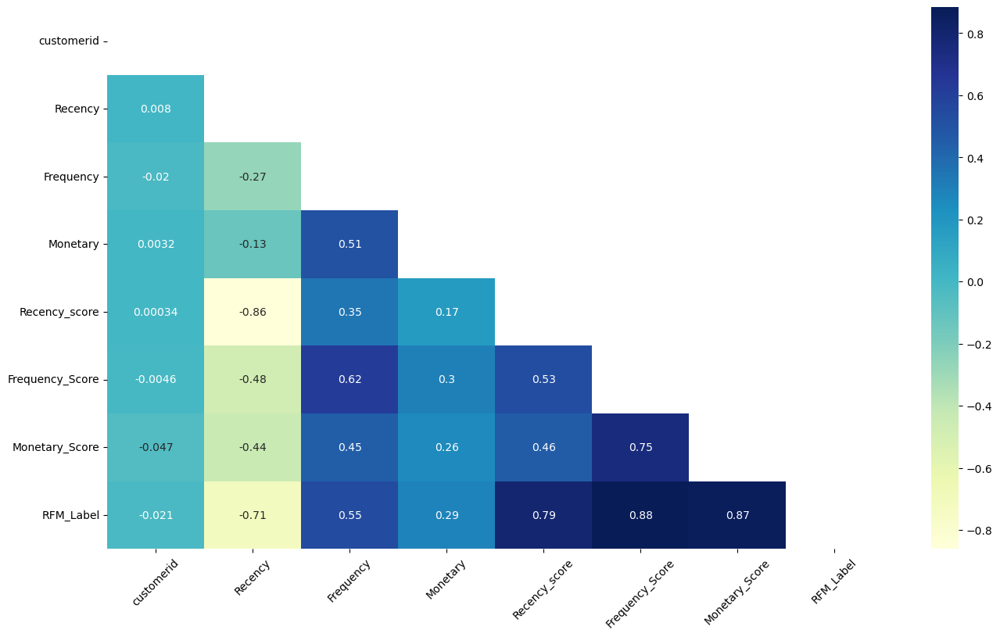

In [167]:
# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(customer_rfm.corr())

# using the upper triangle matrix as mask 
sns.heatmap(customer_rfm.corr(), annot=True, cmap="YlGnBu", mask=matrix)

plt.xticks(rotation=45);


It seems that there have been strong correlations between RFM_Label and the features including RFM scores; however, it should be remembered that RFM_Label were derived from these related RFM scores. So the strong relationship among them is inevitable and acceptable and does NOT create any problem for our analysis.

<AxesSubplot:>

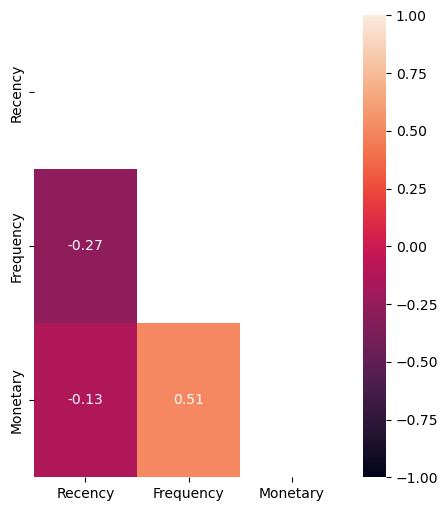

In [168]:
matrix = np.triu(customer_rfm[["Recency", "Frequency", "Monetary"]].corr())
fig, ax = plt.subplots(figsize=(5, 6))
sns.heatmap(customer_rfm[["Recency", "Frequency", "Monetary"]].corr(), annot=True, mask=matrix, ax=ax,vmax=1, vmin=-1)

In [169]:
multicolinearity_control(customer_rfm)

For customerid and customerid, there is NO multicollinearity problem
For customerid and Recency, there is NO multicollinearity problem
For customerid and Frequency, there is NO multicollinearity problem
For customerid and Monetary, there is NO multicollinearity problem
For customerid and Recency_score, there is NO multicollinearity problem
For customerid and Frequency_Score, there is NO multicollinearity problem
For customerid and Monetary_Score, there is NO multicollinearity problem
For customerid and RFM_Label, there is NO multicollinearity problem
For Recency and customerid, there is NO multicollinearity problem
For Recency and Recency, there is NO multicollinearity problem
For Recency and Frequency, there is NO multicollinearity problem
For Recency and Monetary, there is NO multicollinearity problem
Multicolinearity alert in between:Recency - Recency_score

For Recency and Frequency_Score, there is NO multicollinearity problem
For Recency and Monetary_Score, there is NO multicollin

{'Frequency_Score', 'Monetary_Score', 'RFM_Label', 'Recency', 'Recency_score'}

In [170]:
customer_rfm[['Recency', 'Frequency', 'Monetary']].iplot(kind='histogram', subplots=True, bins=50, )

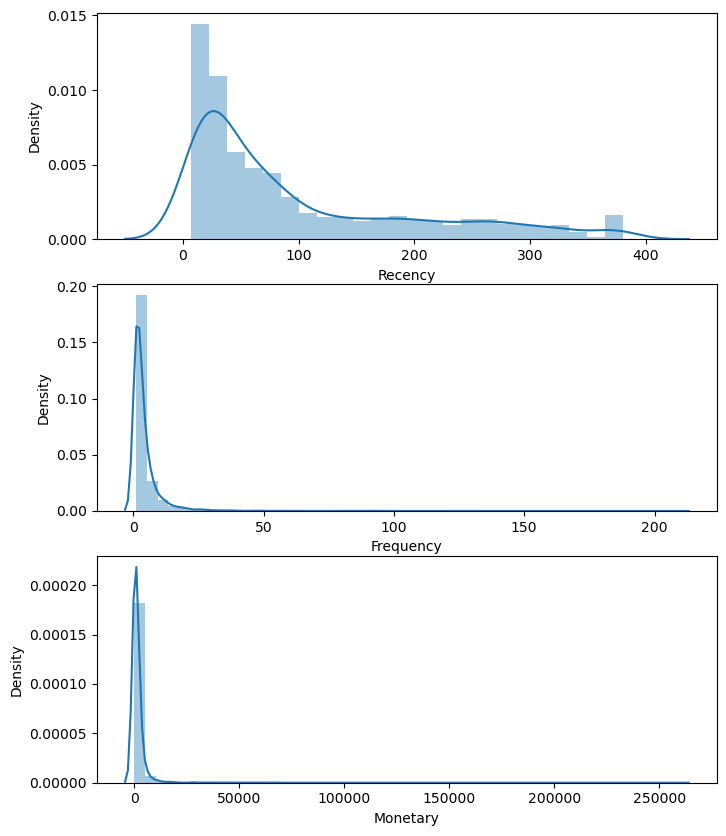

In [171]:
# plot the distribution of RFM values

f, ax = plt.subplots(figsize=(8, 10))
plt.subplot(3, 1, 1); sns.distplot(customer_rfm.Recency, label = 'Recency')
plt.subplot(3, 1, 2); sns.distplot(customer_rfm.Frequency, label = 'Frequency')
plt.subplot(3, 1, 3); sns.distplot(customer_rfm.Monetary, label = 'Monetary')
plt.style.use('fivethirtyeight')
# plt.tight_layout()
plt.show()

### Data Normalization

In [172]:
skew_limit = 0.75 # This is our threshold-limit to evaluate skewness. Overall below abs(1) seems acceptable for the linear models.
skew_vals = customer_rfm[['Recency', 'Frequency', 'Monetary']].skew()
skew_cols = skew_vals[skew_vals>skew_limit].sort_values(ascending=False)

In [173]:
skew_vals,skew_cols

(Recency      1.24
 Frequency   10.75
 Monetary    20.22
 dtype: float64,
 Monetary    20.22
 Frequency   10.75
 Recency      1.24
 dtype: float64)

### **Handling with Skewness - np.log**

In [179]:
rfm_log = customer_rfm[skew_cols.index].copy()

for col in skew_cols.index.values:
    rfm_log[col] = rfm_log[col].apply(np.log1p)

    print(rfm_log.skew())


rfm_log.iplot(kind='histogram', subplots=True, bins=50);

Monetary     0.37
Frequency   10.75
Recency      1.24
dtype: float64
Monetary    0.37
Frequency   1.18
Recency     1.24
dtype: float64
Monetary    0.37
Frequency   1.18
Recency     0.01
dtype: float64


In [194]:
#customer_rfm

In [187]:
for index,skew in enumerate(rfm_log.skew()):
    if -0.75 < skew < 0.75:
        print (f"A skewness value of {rfm_log.skew().index[index]} is", '\033[1m', Fore.GREEN, skew, '\033[0m', "means that the distribution is approx.", '\033[1m', Fore.GREEN, "symmetric", '\033[0m')
    elif  -0.75 < skew < -1.0 or 0.75 < skew < 1.0:
        print (f"A skewness value of {rfm_log.skew().index[index]}", '\033[1m', Fore.YELLOW, skew, '\033[0m', "means that the distribution is approx.", '\033[1m', Fore.YELLOW, "moderately skewed", '\033[0m')
    else:
        print (f"A skewness value of{rfm_log.skew().index[index]}", '\033[1m', Fore.RED, skew, '\033[0m', "means that the distribution is approx.", '\033[1m', Fore.RED, "highly skewed", '\033[0m')

A skewness value of Monetary is   0.37313451126449804  means that the distribution is approx.   symmetric 
A skewness value ofFrequency   1.1822488645974094  means that the distribution is approx.   highly skewed 
A skewness value of Recency is   0.012833254809253406  means that the distribution is approx.   symmetric 


### **Handling with Skewness - Power Transformer**

In [192]:
rfm_pow  = customer_rfm[skew_cols.index].copy()
pt = PowerTransformer(method='yeo-johnson')
trans = pt.fit_transform(rfm_pow)
rfm_pow = pd.DataFrame(trans, columns=skew_cols.index)
print(rfm_pow.skew())

Monetary    -0.01
Frequency    0.22
Recency      0.00
dtype: float64


In [193]:
for index,skew in enumerate(rfm_pow.skew()):
    if -0.75 < skew < 0.75:
        print (f"A skewness value of {rfm_pow.skew().index[index]} is", '\033[1m', Fore.GREEN, skew, '\033[0m', "means that the distribution is approx.", '\033[1m', Fore.GREEN, "symmetric", '\033[0m')
    elif  -0.75 < skew < -1.0 or 0.75 < skew < 1.0:
        print (f"A skewness value of {rfm_pow.skew().index[index]}", '\033[1m', Fore.YELLOW, skew, '\033[0m', "means that the distribution is approx.", '\033[1m', Fore.YELLOW, "moderately skewed", '\033[0m')
    else:
        print (f"A skewness value of{rfm_pow.skew().index[index]}", '\033[1m', Fore.RED, skew, '\033[0m', "means that the distribution is approx.", '\033[1m', Fore.RED, "highly skewed", '\033[0m')

A skewness value of Monetary is   -0.01374891571122692  means that the distribution is approx.   symmetric 
A skewness value of Frequency is   0.21568148042925467  means that the distribution is approx.   symmetric 
A skewness value of Recency is   0.0026472964982634756  means that the distribution is approx.   symmetric 


In [196]:
rfm_pow.iplot(kind = "histogram", subplots = True, bins=50)

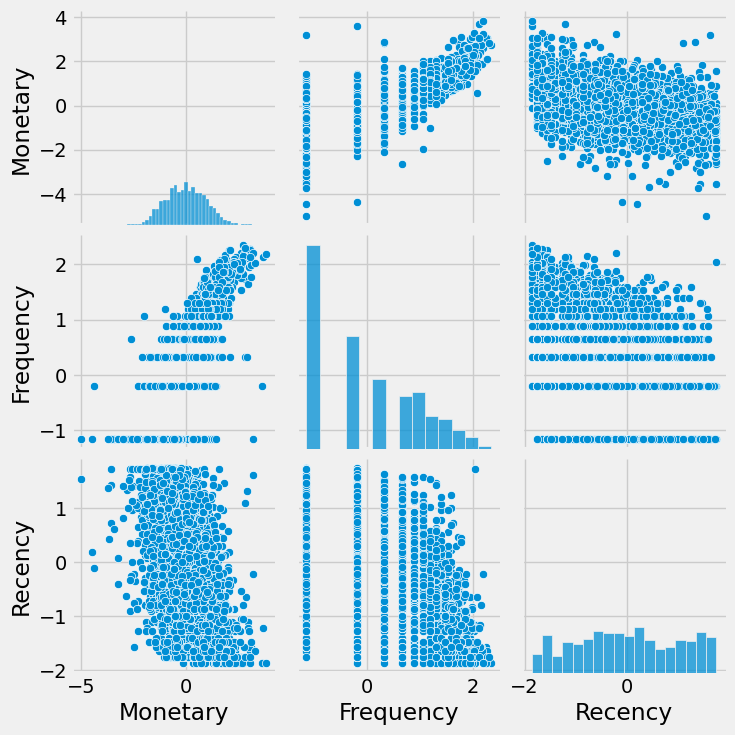

In [198]:
sns.pairplot(rfm_pow)

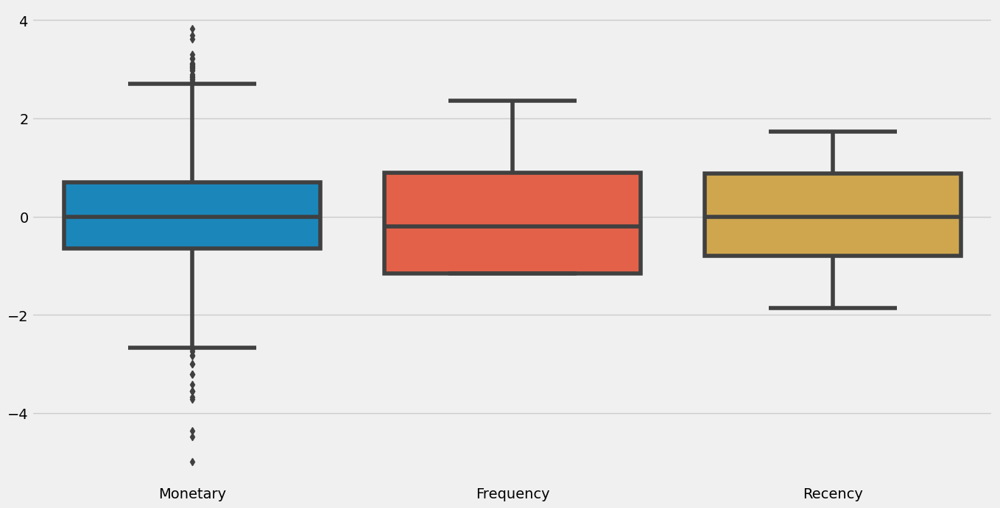

In [199]:
plt.figure(figsize = (15, 8))
sns.boxplot(data = rfm_pow);

In [203]:
fig = px.scatter_3d(rfm_pow, 
                    x='Recency',
                    y='Frequency',
                    z='Monetary',
                    color='Frequency')
fig.show();

With respect to normalization process, 2 different methods werw used; log1p method and PowerTransformer(method='yeo-johnson'). Both revealed different results. Since the results given by PowerTransformer(method='yeo-johnson') are better than the one by log1p, the dataframe normalized by PowerTransformer(method='yeo-johnson') method will be prefered to use for the further analysis